# Introduction to the Fourier Transform using Julia

## Setup

In [2]:
# to install the packages used in this notebook run the following
# using Pkg
# Pkg.add(["FileIO","WAV","LibSndFile","FFTW","Plots","Plotly"])

In [5]:
# load needed packages
using FileIO: load, save, loadstreaming, savestreaming
import LibSndFile
using Hose, WAV, FFTW, Plotly

In [4]:
# helper function
# displays an html player for a given wav file in the notebook
audioplayer(filepath) = """
    <head>
    <meta http-equiv="Content-Type" content="text/html; charset=utf-8">
    <title>Simple Test</title>
    </head>
    
    <body>
    <audio controls="controls" style="width:600px" >
      <source src="$filepath" type="audio/wav" />
      Your browser does not support the audio element.
    </audio>
    </body>
"""

audioplayer (generic function with 1 method)

# A simple wave

In [61]:
freq = 2; #hz, cycles per second
amplitude = 10; # multiplier to the sin
ttime = 2; # total time duration of the wave
fs = 100 # samples per second

100

In [65]:
wave(freq,ampl,fs,ttime) = range(0, ttime, length=ttime*fs) .* 2pi * freq .|> sin |> (x->x.*ampl);

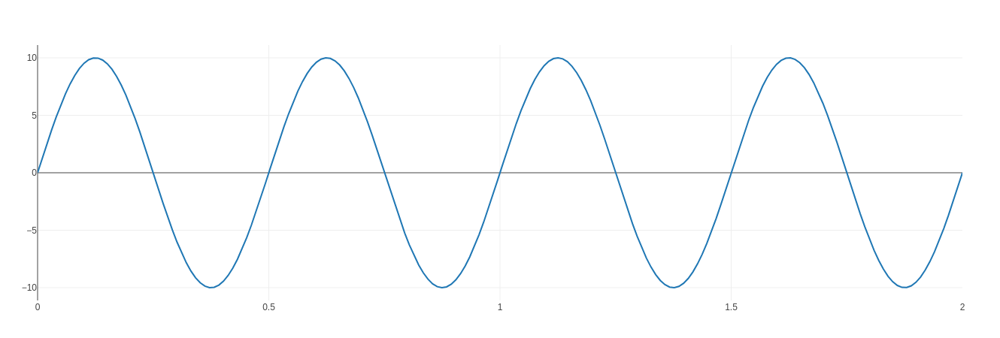

In [62]:
@hose sin.(range(0, ttime, length=ttime*fs) .* 2pi * freq) .* amplitude |> plot(range(0, ttime, length=ttime*fs),_)

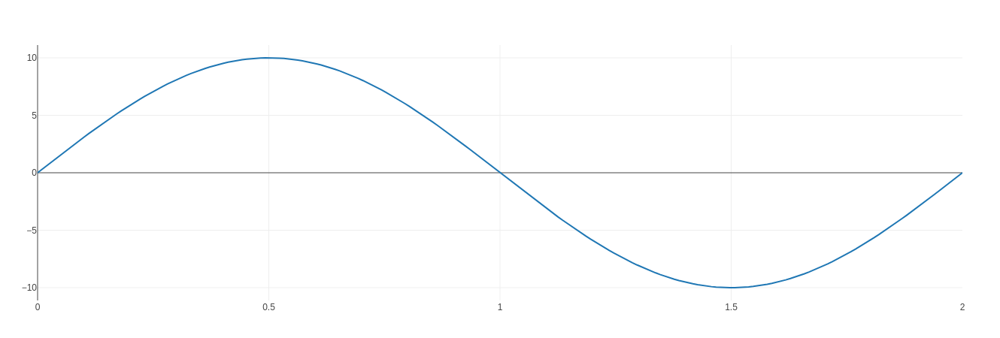

In [90]:
freq = 100
ampl = 10
fs = 100
ttime = 2
plot(range(0,ttime,length=ttime*fs),wave(freq,ampl,fs,ttime))

4.1 deuterolepta

# Real Life example of FFT

In [32]:
display("text/html", audioplayer("audio.wav"))

Simple Test 
 
 
 
 
 
 Your browser does not support the audio element.

In [4]:
y, fs, nbits, opt = wavread("/home/spiros/Documents/audio.wav");

In [8]:
size(y), fs, nbits

((196800, 1), 48000.0f0, 0x0010)

196800 points, 48K metrhseis / sec

In [16]:
nbits, typeof(nbits)

(0x0010, UInt16)

In [10]:
# calculate duration of the audio clip
size(y)[1] / fs

4.1f0

In [11]:
times = collect(1:length(y)) / fs;

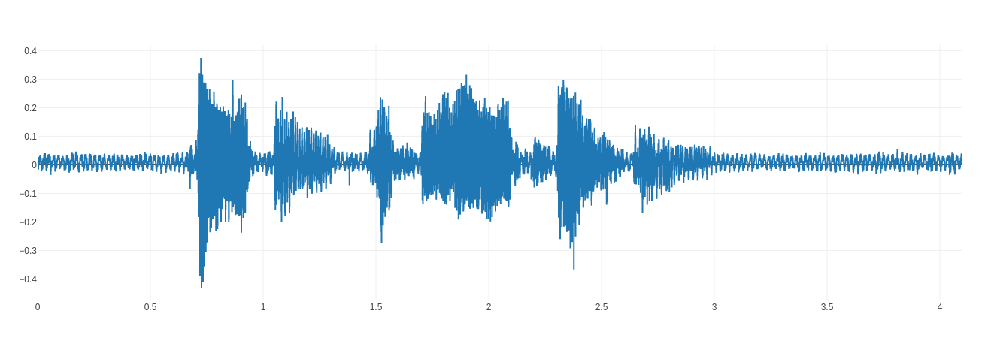

In [22]:
plot(times,y)

In [13]:
yf = fft(y)

196800×1 Array{Complex{Float64},2}:
  1776.7530747398296 + 0.0im
  3.5483201046735555 - 1.490109949483541im
 -2.8123263735992676 - 2.7805279556838487im
   8.607107879168925 - 3.5484543375294773im
   8.853207129219552 - 1.4066950792192294im
  3.1421020363201473 - 1.363619641176951im
 -3.5058104254954836 + 6.0788570538231905im
  -5.567461183766717 - 3.9659728706370982im
    2.33702178816102 - 0.8970607147542288im
   7.901563000926922 - 3.517909911718654im
 -1.6316229564251643 + 3.3570078026351027im
  0.7099845861693783 - 1.8685514531798066im
  2.0854775694469994 - 0.45446614724128054im
                     ⋮
   2.085477569447008 + 0.4544661472412923im
  0.7099845861693757 + 1.8685514531797875im
 -1.6316229564251779 - 3.357007802635102im
  7.9015630009269255 + 3.517909911718636im
   2.337021788161028 + 0.8970607147542232im
  -5.567461183766723 + 3.9659728706370885im
 -3.5058104254954854 - 6.078857053823187im
  3.1421020363201375 + 1.3636196411769435im
    8.85320712921954 + 1.406695079219

In [15]:
abs.(yf)

196800×1 Array{Float64,2}:
 1776.7530747398296
    3.848506622935758
    3.954809141283737
    9.309878314413329
    8.964266145020655
    3.4252392226603345
    7.01735062686259
    6.83561005641622
    2.5032756069387765
    8.6492998563228
    3.7325185677885857
    1.998890353615843
    2.134421741749952
    ⋮
    2.1344217417499625
    1.9988903536158245
    3.7325185677885906
    8.649299856322797
    2.503275606938782
    6.835610056416219
    7.017350626862588
    3.4252392226603225
    8.964266145020643
    9.309878314413327
    3.9548091412837394
    3.848506622935762